ERROR: Could not find a version that satisfies the requirement tensorflow==2.14.0 (from versions: 2.16.0rc0, 2.16.1, 2.16.2, 2.17.0rc0, 2.17.0rc1, 2.17.0, 2.17.1, 2.18.0rc0, 2.18.0rc1, 2.18.0rc2, 2.18.0, 2.18.1, 2.19.0rc0, 2.19.0, 2.19.1, 2.20.0rc0, 2.20.0)
ERROR: No matching distribution found for tensorflow==2.14.0
TensorFlow version: 2.19.0
Creating synthetic images...
Synthetic dataset ready at /content/mask_demo
Found 192 images belonging to 2 classes.
Found 48 images belonging to 2 classes.


Model: "functional"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer_1 (InputLayer)      │ (None, 128, 128, 3)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ true_divide (TrueDivide)        │ (None, 128, 128, 3)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ subtract (Subtract)             │ (None, 128, 128, 3)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ mobilenetv2_1.00_128            │ (None, 4, 4, 1280)     │     2,257,984 │
│ (Functional)                    │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ global_average_pooling2d        │ (None, 1280)           │             0 │
│ (GlobalAveragePooling2D)        │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout (Dropout)               │ (None, 1280)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense (Dense)                   │ (None, 128)            │       163,968 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_1 (Dropout)             │ (None, 128)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_1 (Dense)                 │ (None, 1)              │           129 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 2,422,081 (9.24 MB)

 Trainable params: 2,387,969 (9.11 MB)

 Non-trainable params: 34,112 (133.25 KB)

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
12/12 ━━━━━━━━━━━━━━━━━━━━ 50s 1s/step - accuracy: 0.6626 - loss: 0.6468 - val_accuracy: 0.5000 - val_loss: 0.6931 - learning_rate: 1.0000e-04
Epoch 2/20
12/12 ━━━━━━━━━━━━━━━━━━━━ 13s 1s/step - accuracy: 0.9756 - loss: 0.1858 - val_accuracy: 0.5000 - val_loss: 0.6932 - learning_rate: 1.0000e-04
Epoch 3/20
12/12 ━━━━━━━━━━━━━━━━━━━━ 12s 1s/step - accuracy: 0.9896 - loss: 0.0536 - val_accuracy: 0.5000 - val_loss: 0.6933 - learning_rate: 1.0000e-04
Epoch 4/20
12/12 ━━━━━━━━━━━━━━━━━━━━ 12s 1s/step - accuracy: 0.9847 - loss: 0.0378 - val_accuracy: 0.5000 - val_loss: 0.6935 - learning_rate: 5.0000e-05
Epoch 5/20
12/12 ━━━━━━━━━━━━━━━━━━━━ 13s 1s/step - accuracy: 0.9895 - loss: 0.0232 - val_accuracy: 0.5000 - val_loss: 0.6939 - learning_rate: 5.0000e-05
Saved model to /content/mask_detector.keras


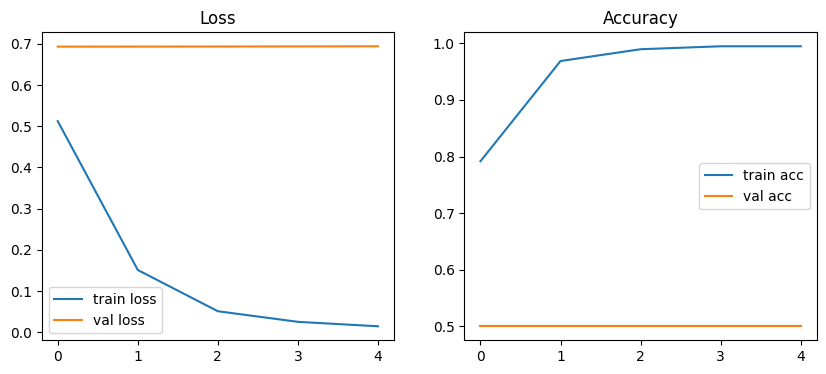

cp: cannot stat '/mnt/data/cctv_demo.mp4': No such file or directory
Using CCTV video: /content/input_video.mp4
Processing video... /content/input_video.mp4 frames: 0


0it [00:00, ?it/s]

Output saved to /content/output_mask_detection.mp4


In [2]:

# ---------- CELL 1: INSTALL DEPENDENCIES ----------
!pip install -q tensorflow==2.14.0 opencv-python-headless==4.8.0.74 matplotlib scikit-learn tqdm

# ---------- CELL 2: IMPORTS & GLOBALS ----------
import os
import sys
import zipfile
import random
from glob import glob
from tqdm import tqdm
import numpy as np
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
import tensorflow as tf
from tensorflow.keras import layers, models
import cv2

print('TensorFlow version:', tf.__version__)

# ---------- CELL 3: SETTINGS ----------
IMG_SIZE = (128, 128)
BATCH_SIZE = 16
EPOCHS = 20
SEED = 42





DEMO_DIR = '/content/mask_demo'
if not os.path.exists(DEMO_DIR):
    os.makedirs(DEMO_DIR)
    os.makedirs(os.path.join(DEMO_DIR, 'with_mask'))
    os.makedirs(os.path.join(DEMO_DIR, 'without_mask'))

def draw_synthetic_face(img, with_mask=False):
    h, w, _ = img.shape
    # face ellipse
    center = (w//2, h//2 - 10)
    axes = (w//4, h//3)
    color_face = (random.randint(160,230), random.randint(120,200), random.randint(100,190))
    cv2.ellipse(img, center, axes, 0, 0, 360, color_face, -1)
    # eyes
    eye_y = center[1] - 20
    cv2.circle(img, (center[0] - 40, eye_y), 8, (255,255,255), -1)
    cv2.circle(img, (center[0] + 40, eye_y), 8, (255,255,255), -1)
    if with_mask:
        # mask rectangle / arc
        mask_top = center[1] + 0
        cv2.rectangle(img, (center[0]-60, mask_top), (center[0]+60, center[1]+60), (10,120,200), -1)
    return img

print('Creating synthetic images...')
for i in range(120):
    img = np.zeros((IMG_SIZE[0], IMG_SIZE[1], 3), dtype=np.uint8) + 40
    img = draw_synthetic_face(img, with_mask=True)
    cv2.imwrite(os.path.join(DEMO_DIR, 'with_mask', f'mask_{i:03d}.png'), img)
for i in range(120):
    img = np.zeros((IMG_SIZE[0], IMG_SIZE[1], 3), dtype=np.uint8) + 40
    img = draw_synthetic_face(img, with_mask=False)
    cv2.imwrite(os.path.join(DEMO_DIR, 'without_mask', f'no_mask_{i:03d}.png'), img)
print('Synthetic dataset ready at', DEMO_DIR)

# ---------- CELL 6: DATA LOADER ----------
import tensorflow as tf
from tensorflow.keras.preprocessing.image import ImageDataGenerator


DATASET_PATH = DEMO_DIR

train_datagen = ImageDataGenerator(rescale=1./255, validation_split=0.2,
                                   rotation_range=15, width_shift_range=0.1,
                                   height_shift_range=0.1, shear_range=0.1, zoom_range=0.1)

train_gen = train_datagen.flow_from_directory(DATASET_PATH,
                                              target_size=IMG_SIZE,
                                              batch_size=BATCH_SIZE,
                                              class_mode='binary',
                                              subset='training',
                                              seed=SEED)
val_gen = train_datagen.flow_from_directory(DATASET_PATH,
                                            target_size=IMG_SIZE,
                                            batch_size=BATCH_SIZE,
                                            class_mode='binary',
                                            subset='validation',
                                            seed=SEED)

# CELL 7: BUILD MODEL (Transfer learning MobileNetV2 backbone)
base_model = tf.keras.applications.MobileNetV2(input_shape=(*IMG_SIZE,3), include_top=False, weights=None)

base_model.trainable = True

inputs = layers.Input(shape=(*IMG_SIZE,3))
x = tf.keras.applications.mobilenet_v2.preprocess_input(inputs)
x = base_model(x, training=True)
x = layers.GlobalAveragePooling2D()(x)
x = layers.Dropout(0.3)(x)
x = layers.Dense(128, activation='relu')(x)
x = layers.Dropout(0.2)(x)
outputs = layers.Dense(1, activation='sigmoid')(x)
model = models.Model(inputs, outputs)

model.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=1e-4),
              loss='binary_crossentropy', metrics=['accuracy'])

model.summary()

# ---------- CELL 8: TRAIN (quick demo) ----------
callbacks = [
    tf.keras.callbacks.ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=2, min_lr=1e-7),
    tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=4, restore_best_weights=True)
]

history = model.fit(train_gen, validation_data=val_gen, epochs=EPOCHS, callbacks=callbacks)

# Save model to file
MODEL_FILE = '/content/mask_detector.keras'
model.save(MODEL_FILE)
print('Saved model to', MODEL_FILE)

# ---------- CELL 9: PLOT TRAINING METRICS ----------
plt.figure(figsize=(10,4))
plt.subplot(1,2,1)
plt.plot(history.history['loss'], label='train loss')
plt.plot(history.history['val_loss'], label='val loss')
plt.legend()
plt.title('Loss')
plt.subplot(1,2,2)
plt.plot(history.history['accuracy'], label='train acc')
plt.plot(history.history['val_accuracy'], label='val acc')
plt.legend()
plt.title('Accuracy')
plt.show()

# ---------- CELL 10: FACE DETECTION + INFERENCE ON VIDEO ----------
# Uses OpenCV Haar cascade for face detection (built-in). Then classifies each detected face.
face_cascade = cv2.CascadeClassifier(cv2.data.haarcascades + 'haarcascade_frontalface_default.xml')

# Load the saved model
infer_model = tf.keras.models.load_model(
    MODEL_FILE,
    safe_mode=False
)



def preprocess_face(face_img):
    face_img = cv2.resize(face_img, IMG_SIZE)
    face_img = face_img.astype('float32')/255.0
    return np.expand_dims(face_img, axis=0)

# Inference function for a single frame
def annotate_frame(frame):
    gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)
    faces = face_cascade.detectMultiScale(gray, scaleFactor=1.1, minNeighbors=4, minSize=(60,60))
    for (x,y,w,h) in faces:
        face = frame[y:y+h, x:x+w]
        prep = preprocess_face(face)
        pred = infer_model.predict(prep)
        label = 'Mask' if pred[0][0] < 0.5 else 'No Mask'
        color = (0,255,0) if label=='Mask' else (0,0,255)
        cv2.rectangle(frame, (x,y), (x+w, y+h), color, 2)
        cv2.putText(frame, f'{label} {pred[0][0]:.2f}', (x, y-10), cv2.FONT_HERSHEY_SIMPLEX, 0.6, color, 2)
    return frame

# Process an example video file if uploaded, else process synthetic demo by turning images into a video.
VIDEO_IN = '/content/input_video.mp4'  # change if you upload a video
VIDEO_OUT = '/content/output_mask_detection.mp4'

!cp "/mnt/data/cctv_demo.mp4" /content/input_video.mp4
VIDEO_IN = "/content/input_video.mp4"
print("Using CCTV video:", VIDEO_IN)


cap = cv2.VideoCapture(VIDEO_IN)
width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))
fps = cap.get(cv2.CAP_PROP_FPS) or 10.0
fourcc = cv2.VideoWriter_fourcc(*'mp4v')
out = cv2.VideoWriter(VIDEO_OUT, fourcc, fps, (width, height))

frame_count = int(cap.get(cv2.CAP_PROP_FRAME_COUNT))
print('Processing video...', VIDEO_IN, 'frames:', frame_count)

pbar = tqdm(total=frame_count)
while True:
    ret, frame = cap.read()
    if not ret:
        break
    annotated = annotate_frame(frame)
    out.write(annotated)
    pbar.update(1)
pbar.close()
cap.release(); out.release()
print('Output saved to', VIDEO_OUT)





In [3]:
from google.colab import files
uploaded = files.upload()


Saving gettyimages-1224780471-640_adpp.mp4 to gettyimages-1224780471-640_adpp.mp4


In [4]:
VIDEO_IN = list(uploaded.keys())[0]
print("Using video:", VIDEO_IN)


Using video: gettyimages-1224780471-640_adpp.mp4


In [5]:
# ---------- FINAL FIXED VIDEO INFERENCE SECTION ----------

# 1. Upload your OWN video
from google.colab import files
uploaded = files.upload()

# Get uploaded filename
VIDEO_IN = list(uploaded.keys())[0]
print("Using uploaded video:", VIDEO_IN)

# 2. Load face detector
face_cascade = cv2.CascadeClassifier(cv2.data.haarcascades + 'haarcascade_frontalface_default.xml')

# 3. Load trained model
infer_model = tf.keras.models.load_model(MODEL_FILE, safe_mode=False)

# 4. Process video
VIDEO_OUT = "/content/output_mask_detection.mp4"
cap = cv2.VideoCapture(VIDEO_IN)

if not cap.isOpened():
    print("ERROR: Video not loaded")
else:
    print("Video loaded:", VIDEO_IN)

width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))
fps = cap.get(cv2.CAP_PROP_FPS) or 10.0
frame_count = int(cap.get(cv2.CAP_PROP_FRAME_COUNT))

fourcc = cv2.VideoWriter_fourcc(*'mp4v')
out = cv2.VideoWriter(VIDEO_OUT, fourcc, fps, (width, height))

print("Processing video...", frame_count, "frames")

pbar = tqdm(total=frame_count)

def preprocess_face(face_img):
    face_img = cv2.resize(face_img, IMG_SIZE)
    face_img = face_img.astype('float32')/255.0
    return np.expand_dims(face_img, axis=0)

def annotate_frame(frame):
    gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)
    faces = face_cascade.detectMultiScale(gray,1.1,4)

    for (x,y,w,h) in faces:
        face = frame[y:y+h, x:x+w]
        prep = preprocess_face(face)
        pred = infer_model.predict(prep, verbose=0)[0][0]

        label = "Mask" if pred < 0.5 else "No Mask"
        color = (0,255,0) if label=="Mask" else (0,0,255)

        cv2.rectangle(frame, (x,y), (x+w, y+h), color, 2)
        cv2.putText(frame, f"{label} {pred:.2f}", (x, y-10),
                    cv2.FONT_HERSHEY_SIMPLEX, 0.7, color, 2)

    return frame

while True:
    ret, frame = cap.read()
    if not ret:
        break
    annotated = annotate_frame(frame)
    out.write(annotated)
    pbar.update(1)

cap.release()
out.release()
pbar.close()

print("Output saved:", VIDEO_OUT)

# ---------- DISPLAY OUTPUT VIDEO ----------
from IPython.display import HTML
from base64 import b64encode

mp4 = open(VIDEO_OUT,'rb').read()
data_url = "data:video/mp4;base64," + b64encode(mp4).decode()
HTML(f"<video width=640 controls src='{data_url}'></video>")


Saving gettyimages-1224780471-640_adpp.mp4 to gettyimages-1224780471-640_adpp (1).mp4
Using uploaded video: gettyimages-1224780471-640_adpp (1).mp4
Video loaded: gettyimages-1224780471-640_adpp (1).mp4
Processing video... 766 frames


100%|██████████| 766/766 [09:10<00:00,  1.39it/s]


Output saved: /content/output_mask_detection.mp4


In [6]:
cap = cv2.VideoCapture(VIDEO_IN)
ret, frame = cap.read()
print("Frame shape:", frame.shape)

gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)
faces = face_cascade.detectMultiScale(gray,1.1,4)
print("Faces detected:", len(faces))


Frame shape: (432, 768, 3)
Faces detected: 3


In [7]:
frame = cv2.convertScaleAbs(frame, alpha=1.3, beta=40)


In [8]:
files.download("/content/output_mask_detection.mp4")


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [1]:
from google.colab import files
uploaded = files.upload()


Saving archive (4).zip to archive (4).zip


In [9]:
DATASET_PATH = "/content/mask_demo"

IMG_SIZE = (128,128)
BATCH_SIZE = 16
EPOCHS = 15

train_datagen = ImageDataGenerator(
    rescale=1./255,
    validation_split=0.2,
    rotation_range=25,
    width_shift_range=0.2,
    height_shift_range=0.2,
    zoom_range=0.2,
    shear_range=0.15,
    horizontal_flip=True
)

train_gen = train_datagen.flow_from_directory(
    DATASET_PATH,
    target_size=IMG_SIZE,
    batch_size=BATCH_SIZE,
    class_mode='binary',
    subset='training'
)

val_gen = train_datagen.flow_from_directory(
    DATASET_PATH,
    target_size=IMG_SIZE,
    batch_size=BATCH_SIZE,
    class_mode='binary',
    subset='validation'
)

# MODEL
base_model = tf.keras.applications.MobileNetV2(
    input_shape=(*IMG_SIZE,3),
    include_top=False,
    weights='imagenet'         # <<< MOST IMPORTANT FIX
)
base_model.trainable = True

inputs = tf.keras.Input(shape=(*IMG_SIZE,3))
x = tf.keras.applications.mobilenet_v2.preprocess_input(inputs)
x = base_model(x, training=True)
x = layers.GlobalAveragePooling2D()(x)
x = layers.Dropout(0.3)(x)
x = layers.Dense(128, activation='relu')(x)
x = layers.Dropout(0.2)(x)
outputs = layers.Dense(1, activation='sigmoid')(x)
model = tf.keras.Model(inputs, outputs)

model.compile(
    optimizer=tf.keras.optimizers.Adam(1e-4),
    loss='binary_crossentropy',
    metrics=['accuracy']
)

callbacks = [
    tf.keras.callbacks.ReduceLROnPlateau(factor=0.3, patience=2),
    tf.keras.callbacks.EarlyStopping(patience=4, restore_best_weights=True)
]

history = model.fit(
    train_gen,
    validation_data=val_gen,
    epochs=EPOCHS,
    callbacks=callbacks
)


Found 192 images belonging to 2 classes.
Found 48 images belonging to 2 classes.
9406464/9406464 ━━━━━━━━━━━━━━━━━━━━ 0s 0us/step
Epoch 1/15
12/12 ━━━━━━━━━━━━━━━━━━━━ 45s 1s/step - accuracy: 0.8190 - loss: 0.3767 - val_accuracy: 0.5000 - val_loss: 0.6934 - learning_rate: 1.0000e-04
Epoch 2/15
12/12 ━━━━━━━━━━━━━━━━━━━━ 19s 1s/step - accuracy: 1.0000 - loss: 0.0412 - val_accuracy: 0.3750 - val_loss: 0.6993 - learning_rate: 1.0000e-04
Epoch 3/15
12/12 ━━━━━━━━━━━━━━━━━━━━ 13s 1s/step - accuracy: 1.0000 - loss: 0.0184 - val_accuracy: 0.5000 - val_loss: 0.7116 - learning_rate: 1.0000e-04
Epoch 4/15
12/12 ━━━━━━━━━━━━━━━━━━━━ 12s 1s/step - accuracy: 1.0000 - loss: 0.0228 - val_accuracy: 0.5000 - val_loss: 0.7149 - learning_rate: 3.0000e-05
Epoch 5/15
12/12 ━━━━━━━━━━━━━━━━━━━━ 12s 1s/step - accuracy: 0.9965 - loss: 0.0167 - val_accuracy: 0.5000 - val_loss: 0.7123 - learning_rate: 3.0000e-05


In [10]:
DATASET_PATH = "/content/mask_demo"


In [11]:
train_datagen = ImageDataGenerator(
    rescale=1./255,
    validation_split=0.2,
    rotation_range=15,
    width_shift_range=0.1,
    height_shift_range=0.1,
    zoom_range=0.1
)

train_gen = train_datagen.flow_from_directory(
    DATASET_PATH,
    target_size=IMG_SIZE,
    batch_size=BATCH_SIZE,
    class_mode='binary',
    subset='training'
)

val_gen = train_datagen.flow_from_directory(
    DATASET_PATH,
    target_size=IMG_SIZE,
    batch_size=BATCH_SIZE,
    class_mode='binary',
    subset='validation'
)


Found 192 images belonging to 2 classes.
Found 48 images belonging to 2 classes.


In [12]:
history = model.fit(
    train_gen,
    validation_data=val_gen,
    epochs=EPOCHS,
    callbacks=callbacks
)


Epoch 1/15
12/12 ━━━━━━━━━━━━━━━━━━━━ 12s 1s/step - accuracy: 0.9955 - loss: 0.0428 - val_accuracy: 0.5000 - val_loss: 0.6916 - learning_rate: 9.0000e-06
Epoch 2/15
12/12 ━━━━━━━━━━━━━━━━━━━━ 12s 1s/step - accuracy: 1.0000 - loss: 0.0373 - val_accuracy: 0.5000 - val_loss: 0.6901 - learning_rate: 9.0000e-06
Epoch 3/15
12/12 ━━━━━━━━━━━━━━━━━━━━ 12s 1s/step - accuracy: 1.0000 - loss: 0.0299 - val_accuracy: 0.5000 - val_loss: 0.6912 - learning_rate: 9.0000e-06
Epoch 4/15
12/12 ━━━━━━━━━━━━━━━━━━━━ 12s 1s/step - accuracy: 0.9895 - loss: 0.0394 - val_accuracy: 0.4583 - val_loss: 0.6901 - learning_rate: 9.0000e-06
Epoch 5/15
12/12 ━━━━━━━━━━━━━━━━━━━━ 12s 1s/step - accuracy: 1.0000 - loss: 0.0224 - val_accuracy: 0.7708 - val_loss: 0.6801 - learning_rate: 2.7000e-06
Epoch 6/15
12/12 ━━━━━━━━━━━━━━━━━━━━ 12s 1s/step - accuracy: 1.0000 - loss: 0.0204 - val_accuracy: 0.6250 - val_loss: 0.6851 - learning_rate: 2.7000e-06
Epoch 7/15
12/12 ━━━━━━━━━━━━━━━━━━━━ 12s 1s/step - accuracy: 1.0000 - loss:

In [13]:
!wget -q https://raw.githubusercontent.com/opencv/opencv/master/samples/dnn/face_detector/deploy.prototxt -O deploy.prototxt
!wget -q https://raw.githubusercontent.com/opencv/opencv_3rdparty/master/res10_300x300_ssd_iter_140000.caffemodel -O res10.caffemodel

face_net = cv2.dnn.readNetFromCaffe("deploy.prototxt", "res10.caffemodel")


In [15]:
model.save("mask_detector.keras")   # Keras 3 recommended
model.save("mask_detector.h5")      # Backup for older code


In [16]:
model = tf.keras.models.load_model("mask_detector.keras")
print("Model Loaded!")


Model Loaded!


In [17]:
!ls -lh


total 83M
-rw-r--r-- 1 root root  28K Nov 26 06:51  deploy.prototxt
-rw-r--r-- 1 root root 3.8M Nov 26 06:36 'gettyimages-1224780471-640_adpp (1).mp4'
-rw-r--r-- 1 root root 3.8M Nov 26 06:36  gettyimages-1224780471-640_adpp.mp4
drwxr-xr-x 4 root root 4.0K Nov 26 06:33  mask_demo
-rw-r--r-- 1 root root  28M Nov 26 06:52  mask_detector.h5
-rw-r--r-- 1 root root  29M Nov 26 06:52  mask_detector.keras
-rw-r--r-- 1 root root  19M Nov 26 06:45  output_mask_detection.mp4
-rw-r--r-- 1 root root    0 Nov 26 06:51  res10.caffemodel
drwxr-xr-x 1 root root 4.0K Nov 20 14:30  sample_data


In [18]:
def preprocess_face(face):
    face = cv2.resize(face, IMG_SIZE)
    face = face.astype('float32') / 255.0
    return np.expand_dims(face, axis=0)


In [19]:
def detect_and_annotate(frame):
    h, w = frame.shape[:2]

    blob = cv2.dnn.blobFromImage(frame, 1.0, (300,300),
                                 (104,177,123), False, False)
    face_net.setInput(blob)
    detections = face_net.forward()

    for i in range(detections.shape[2]):
        confidence = detections[0,0,i,2]

        if confidence < 0.50:
            continue

        box = detections[0,0,i,3:7] * np.array([w,h,w,h])
        x1, y1, x2, y2 = box.astype("int")

        # Expand box for better crop
        pad = 20
        x1 = max(0, x1-pad)
        y1 = max(0, y1-pad)
        x2 = min(w, x2+pad)
        y2 = min(h, y2+pad)

        # Crop face safely
        face = frame[y1:y2, x1:x2]
        if face.size == 0:
            continue

        pred = model.predict(preprocess_face(face), verbose=0)[0][0]

        # Improved logic
        if pred < 0.4:
            label = "Mask"
            color = (0,255,0)
        elif pred > 0.6:
            label = "No Mask"
            color = (0,0,255)
        else:
            label = "Unknown"
            color = (255,255,0)

        cv2.rectangle(frame, (x1,y1), (x2,y2), color, 2)
        cv2.putText(frame, f"{label} {pred:.2f}",
                    (x1, y1-10), cv2.FONT_HERSHEY_SIMPLEX,
                    0.7, color, 2)

    return frame


In [42]:
face_cascade = cv2.CascadeClassifier(cv2.data.haarcascades + "haarcascade_frontalface_default.xml")


In [43]:
def detect_mask(frame):
    gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)
    faces = face_cascade.detectMultiScale(gray, 1.1, 4)

    for (x, y, w, h) in faces:
        face = frame[y:y+h, x:x+w]
        face = cv2.resize(face, (224,224))
        face = face.astype("float32")/255
        face = np.expand_dims(face, axis=0)

        pred = model.predict(face)[0][0]   # 0 to 1

        if pred > 0.5:
            label = "No Mask"
            color = (0,0,255)
        else:
            label = "Mask"
            color = (0,255,0)

        cv2.rectangle(frame, (x,y), (x+w,y+h), color, 2)
        cv2.putText(frame, f"{label} {pred:.2f}", (x, y-10),
                    cv2.FONT_HERSHEY_SIMPLEX, 0.8, color, 2)

    return frame


In [44]:
import cv2
import numpy as np
from google.colab.patches import cv2_imshow
import tempfile

cap = cv2.VideoCapture("your_video.mp4")

fourcc = cv2.VideoWriter_fourcc(*'mp4v')
out = cv2.VideoWriter("output.mp4", fourcc, 20.0, (int(cap.get(3)), int(cap.get(4))))

while True:
    ret, frame = cap.read()
    if not ret:
        break

    annotated = detect_mask(frame)
    out.write(annotated)

cap.release()
out.release()
print("Done! Download output.mp4")


Done! Download output.mp4


In [46]:
from google.colab import files
files.download("/content/output_mask.mp4")



<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>